A recreation of <https://gpflow.readthedocs.io/en/master/notebooks/advanced/gps_for_big_data.html>

# Regression: Sparse Variational Gaussian Process for Stochastic Optimisation with Flux.jl

*You are seeing the
notebook output generated by
[Literate.jl](https://github.com/fredrikekre/Literate.jl) from the
[Julia source file](https://github.com/JuliaGaussianProcesses/ApproximateGPs.jl/blob/master/examples/a-regression/script.jl).
The rendered HTML can be viewed [in the docs](https://juliagaussianprocesses.github.io/ApproximateGPs.jl/dev/examples/a-regression/).*

In this example, we show how to construct and train the stochastic variational
Gaussian process (SVGP) model for efficient inference in large scale datasets.
For a basic introduction to the functionality of this library, please refer to
the User Guide.

## Setup

In [1]:
using ApproximateGPs
using Distributions
using LinearAlgebra

using Plots
default(; palette=:seaborn_colorblind, legend=:outertopright, size=(700, 400))

using Random
Random.seed!(1234);

## Generate some training data

We define a data-generating function `g`:

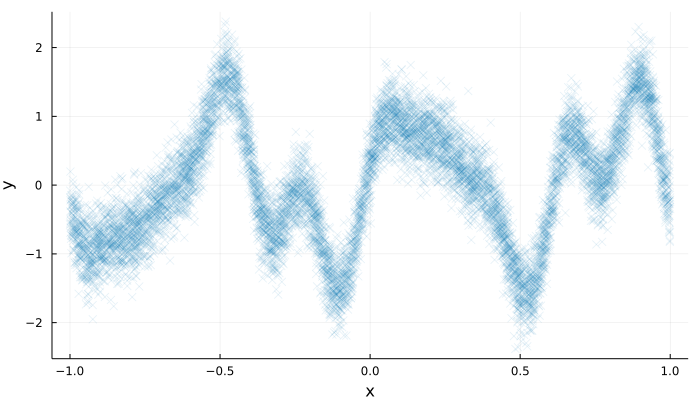

In [2]:
g(x) = sin(3π * x) + 0.3 * cos(9π * x) + 0.5 * sin(7π * x)

N = 10000 # Number of training points
x = rand(Uniform(-1, 1), N)
y = g.(x) + 0.3 * randn(N)

scatter(x, y; xlabel="x", ylabel="y", markershape=:xcross, markeralpha=0.1, legend=false)

## Set up a Flux model

We shall use the excellent framework provided by [Flux.jl](https://fluxml.ai/)
to perform stochastic optimisation. The SVGP approximation has three sets of
parameters to optimise - the inducing input locations, the mean and covariance
of the variational distribution `q` and the parameters of the
kernel.

First, we define a helper function to construct the kernel from its
parameters (often called kernel hyperparameters), and pick some
initial values `k_init`. Since Flux performs optimisation on
unconstrained parameters, we need to use softplus to ensure that the
kernel parameters are positive.

In [3]:
using StatsFuns: softplus, invsoftplus

function make_kernel(k_params)
    variance = softplus(k_params[1])
    lengthscale = softplus(k_params[2])
    return variance * with_lengthscale(SqExponentialKernel(), lengthscale)
end

init_variance = 1.3
init_lengthscale = 0.3
k_init = [invsoftplus(init_variance), invsoftplus(init_lengthscale)];

Then, we select some inducing input locations `z_init`. In this
case, we simply choose the first `M` data inputs.

In [4]:
M = 20 # number of inducing points
z_init = x[1:M];

Given a set of parameters, we now define a Flux 'layer' which forms
the basis of our model.

In [5]:
using Flux

struct SVGPModel
    k  # kernel parameters
    z  # inducing points
    m  # variational mean
    A  # square-root of variational covariance
end

Flux.@functor SVGPModel (k, z, m, A);

Set the observation noise for our model, along with a `jitter` term
to help with numerical stability.

In [6]:
lik_noise = 0.3
jitter = 1e-5;

Next, we define some useful functions on the model - creating the prior GP
under the model, as well as the `SparseVariationalApproximation` struct
needed to create the posterior approximation and to compute the ELBO.

In [7]:
function prior(m::SVGPModel)
    kernel = make_kernel(m.k)
    return GP(kernel)
end

prior (generic function with 1 method)

The variational distribution is given by `q(u)` where ``u ~ f(z)`` are the
pseudo-points. We parameterise the covariance matrix of ``q`` as ``S = A A^T``
since this guarantees that ``S`` is positive definite. We also only use the
lower triangular part of `A`, to ensure the minimum number of free parameters.

In [8]:
using PDMats: PDMat

function make_approx(m::SVGPModel, prior)
    # Efficiently constructs S as A*Aᵀ
    S = PDMat(Cholesky(LowerTriangular(m.A)))
    q = MvNormal(m.m, S)
    fz = prior(m.z, jitter)
    return SparseVariationalApproximation(fz, q)
end;

Create the approximate posterior GP under the model.

In [9]:
function model_posterior(m::SVGPModel)
    svgp = make_approx(m, prior(m))
    return posterior(svgp)
end;

Define a predictive function for the model - in this case the prediction is
the joint distribution of the approximate posterior GP at some test inputs `x`
(defined by an `AbstractGPs.FiniteGP`).

In [10]:
function (m::SVGPModel)(x)
    post = model_posterior(m)
    return post(x)
end;

Return the loss given data - for the SVGP model as constructed using `SparseVariationalApproximation`, the
loss used is the negative ELBO (also known as the Variational Free Energy).
`num_data` is required for minibatching used below.

In [11]:
function loss(m::SVGPModel, x, y; num_data=length(y))
    f = prior(m)
    fx = f(x, lik_noise)
    svgp = make_approx(m, f)
    return -elbo(svgp, fx, y; num_data)
end;

Finally, we choose some initial parameters and instantiate our model.

In [12]:
m_init = zeros(M)
A_init = Matrix{Float64}(I, M, M)

model = SVGPModel(k_init, z_init, m_init, A_init);

Taking a look at the model posterior under these initial parameters shows a
very poor fit to the data, as expected:

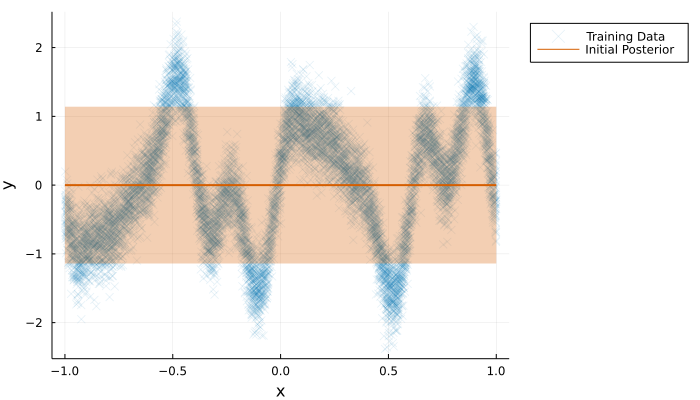

In [13]:
init_post = model_posterior(model)
scatter(
    x,
    y;
    xlabel="x",
    ylabel="y",
    markershape=:xcross,
    markeralpha=0.1,
    label="Training Data",
)
plot!(-1:0.001:1, init_post; label="Initial Posterior", color=4)

## Training the model

Training the model now simply proceeds with the usual `Flux.jl` training loop.

In [14]:
opt = ADAM(0.001)  # Define the optimiser
params = Flux.params(model);  # Extract the model parameters

One of the major advantages of the SVGP model is that it allows stochastic
estimation of the ELBO by using minibatching of the training data. This is
very straightforward to achieve with `Flux.jl`'s utilities:

In [15]:
b = 100 # minibatch size
data_loader = Flux.Data.DataLoader((x, y); batchsize=b)

Flux.Data.DataLoader{Tuple{Vector{Float64}, Vector{Float64}}, Random._GLOBAL_RNG}(([0.18168927733142048, 0.5335940730045183, 0.13247483301237173, -0.07982931507496582, 0.5880514206635885, 0.7082931807581003, -0.5988279301323178, -0.4027714433131764, -0.506325626779982, 0.15934446673808322  …  0.20228213333532974, 0.43128929722102516, -0.013851089501626834, -0.842007186496295, 0.9449592233807151, 0.11531570335622465, 0.8855698790802209, 0.21268746214945766, 0.963327954905584, -0.9888915520035928], [0.830715721094028, -1.994972979913132, 0.17529353265183645, -1.6186491595601078, -0.8923379243645142, 0.497453723631885, 0.45441028902775493, 0.7050880663863939, 1.7398168868800505, 0.8263166696284232  …  1.069157780939488, -0.2150177342239235, 0.46303759954707346, 0.0031137864385547553, 0.5510615580321441, 0.9913944243820315, 1.536633245555434, 0.8383240177185101, 0.46951872861675414, -0.9464875620164421]), 100, 10000, true, 10000, [1, 2, 3, 4, 5, 6, 7, 8, 9, 10  …  9991, 9992, 9993, 9994, 9

The loss (negative ELBO) before training

In [16]:
loss(model, x, y)

37436.40140920067

Train the model. N.B. when using minibatching, the length of the
full dataset `num_data` must be passed to the loss.

In [17]:
using IterTools: ncycle

Flux.train!(
    (x, y) -> loss(model, x, y; num_data=N),
    params,
    ncycle(data_loader, 300), # Train for 300 epochs
    opt,
);

Negative ELBO after training

In [18]:
loss(model, x, y)

5029.40583007662

Finally, we plot the optimised approximate posterior to see the
results.

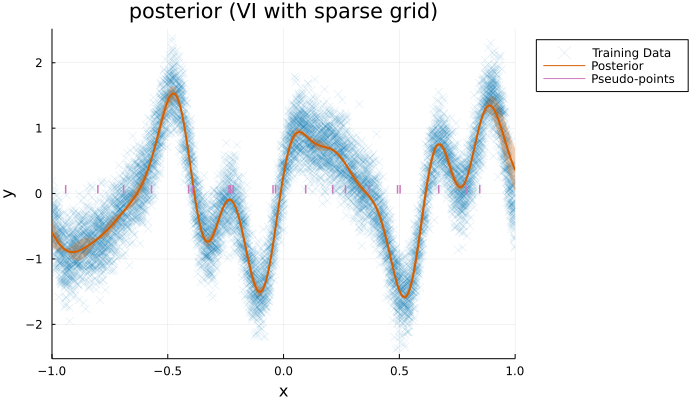

In [19]:
post = model_posterior(model)

scatter(
    x,
    y;
    markershape=:xcross,
    markeralpha=0.1,
    xlim=(-1, 1),
    xlabel="x",
    ylabel="y",
    title="posterior (VI with sparse grid)",
    label="Training Data",
    color=1,
)
plot!(-1:0.001:1, post; label="Posterior", color=4)
sticks!(model.z, fill(0.13, M); label="Pseudo-points", linewidth=1.5, color=5)

### Package and system information
#### Package version
```julia
      Status `~/work/ApproximateGPs.jl/ApproximateGPs.jl/examples/a-regression/Project.toml`
  [298c2ebc] ApproximateGPs v0.2.7
  [31c24e10] Distributions v0.25.41
  [587475ba] Flux v0.12.8
  [c8e1da08] IterTools v1.4.0
  [98b081ad] Literate v2.11.0
  [90014a1f] PDMats v0.11.5
  [91a5bcdd] Plots v1.25.7
  [4c63d2b9] StatsFuns v0.9.15
  [37e2e46d] LinearAlgebra
  [9a3f8284] Random
```
#### Computer information
```julia
Julia Version 1.6.5
Commit 9058264a69 (2021-12-19 12:30 UTC)
Platform Info:
  OS: Linux (x86_64-pc-linux-gnu)
  CPU: Intel(R) Xeon(R) Platinum 8272CL CPU @ 2.60GHz
  WORD_SIZE: 64
  LIBM: libopenlibm
  LLVM: libLLVM-11.0.1 (ORCJIT, skylake-avx512)
Environment:
  JULIA_DEBUG = Documenter
```
#### Manifest
```@raw html
<details>
<summary> Show the full Manifest </summary>
```
```julia
      Status `~/work/ApproximateGPs.jl/ApproximateGPs.jl/examples/a-regression/Manifest.toml`
  [621f4979] AbstractFFTs v1.1.0
  [99985d1d] AbstractGPs v0.5.4
  [1520ce14] AbstractTrees v0.3.4
  [79e6a3ab] Adapt v3.3.3
  [298c2ebc] ApproximateGPs v0.2.7
  [4fba245c] ArrayInterface v3.2.2
  [ab4f0b2a] BFloat16s v0.2.0
  [fa961155] CEnum v0.4.1
  [052768ef] CUDA v3.7.1
  [082447d4] ChainRules v1.25.0
  [d360d2e6] ChainRulesCore v1.11.6
  [9e997f8a] ChangesOfVariables v0.1.2
  [944b1d66] CodecZlib v0.7.0
  [35d6a980] ColorSchemes v3.16.0
  [3da002f7] ColorTypes v0.11.0
  [5ae59095] Colors v0.12.8
  [bbf7d656] CommonSubexpressions v0.3.0
  [34da2185] Compat v3.41.0
  [a33af91c] CompositionsBase v0.1.1
  [d38c429a] Contour v0.5.7
  [9a962f9c] DataAPI v1.9.0
  [864edb3b] DataStructures v0.18.11
  [e2d170a0] DataValueInterfaces v1.0.0
  [b429d917] DensityInterface v0.4.0
  [163ba53b] DiffResults v1.0.3
  [b552c78f] DiffRules v1.9.0
  [b4f34e82] Distances v0.10.7
  [31c24e10] Distributions v0.25.41
  [ffbed154] DocStringExtensions v0.8.6
  [e2ba6199] ExprTools v0.1.8
  [c87230d0] FFMPEG v0.4.1
  [442a2c76] FastGaussQuadrature v0.4.9
  [1a297f60] FillArrays v0.12.7
  [53c48c17] FixedPointNumbers v0.8.4
  [587475ba] Flux v0.12.8
  [59287772] Formatting v0.4.2
  [f6369f11] ForwardDiff v0.10.25
  [d9f16b24] Functors v0.2.7
  [6031954c] GPLikelihoods v0.2.6
  [0c68f7d7] GPUArrays v8.2.1
  [61eb1bfa] GPUCompiler v0.13.11
  [28b8d3ca] GR v0.63.1
  [5c1252a2] GeometryBasics v0.4.1
  [42e2da0e] Grisu v1.0.2
  [cd3eb016] HTTP v0.9.17
  [b5f81e59] IOCapture v0.2.2
  [7869d1d1] IRTools v0.4.4
  [615f187c] IfElse v0.1.1
  [83e8ac13] IniFile v0.5.0
  [3587e190] InverseFunctions v0.1.2
  [92d709cd] IrrationalConstants v0.1.1
  [c8e1da08] IterTools v1.4.0
  [82899510] IteratorInterfaceExtensions v1.0.0
  [692b3bcd] JLLWrappers v1.4.0
  [682c06a0] JSON v0.21.2
  [e5e0dc1b] Juno v0.8.4
  [ec8451be] KernelFunctions v0.10.26
  [929cbde3] LLVM v4.7.1
  [b964fa9f] LaTeXStrings v1.3.0
  [23fbe1c1] Latexify v0.15.9
  [98b081ad] Literate v2.11.0
  [2ab3a3ac] LogExpFunctions v0.3.6
  [1914dd2f] MacroTools v0.5.9
  [739be429] MbedTLS v1.0.3
  [442fdcdd] Measures v0.3.1
  [e89f7d12] Media v0.5.0
  [e1d29d7a] Missings v1.0.2
  [872c559c] NNlib v0.7.34
  [a00861dc] NNlibCUDA v0.1.11
  [77ba4419] NaNMath v0.3.6
  [bac558e1] OrderedCollections v1.4.1
  [90014a1f] PDMats v0.11.5
  [69de0a69] Parsers v2.2.0
  [ccf2f8ad] PlotThemes v2.0.1
  [995b91a9] PlotUtils v1.1.3
  [91a5bcdd] Plots v1.25.7
  [21216c6a] Preferences v1.2.3
  [1fd47b50] QuadGK v2.4.2
  [74087812] Random123 v1.4.2
  [e6cf234a] RandomNumbers v1.5.3
  [c1ae055f] RealDot v0.1.0
  [3cdcf5f2] RecipesBase v1.2.1
  [01d81517] RecipesPipeline v0.5.0
  [189a3867] Reexport v1.2.2
  [05181044] RelocatableFolders v0.1.3
  [ae029012] Requires v1.3.0
  [79098fc4] Rmath v0.7.0
  [6c6a2e73] Scratch v1.1.0
  [992d4aef] Showoff v1.0.3
  [a2af1166] SortingAlgorithms v1.0.1
  [276daf66] SpecialFunctions v1.8.1
  [aedffcd0] Static v0.4.1
  [90137ffa] StaticArrays v1.3.3
  [82ae8749] StatsAPI v1.2.0
  [2913bbd2] StatsBase v0.33.14
  [4c63d2b9] StatsFuns v0.9.15
  [09ab397b] StructArrays v0.6.4
  [3783bdb8] TableTraits v1.0.1
  [bd369af6] Tables v1.6.1
  [62fd8b95] TensorCore v0.1.1
  [a759f4b9] TimerOutputs v0.5.15
  [3bb67fe8] TranscodingStreams v0.9.6
  [5c2747f8] URIs v1.3.0
  [1cfade01] UnicodeFun v0.4.1
  [41fe7b60] Unzip v0.1.2
  [a5390f91] ZipFile v0.9.4
  [e88e6eb3] Zygote v0.6.34
  [700de1a5] ZygoteRules v0.2.2
  [6e34b625] Bzip2_jll v1.0.8+0
  [83423d85] Cairo_jll v1.16.1+1
  [5ae413db] EarCut_jll v2.2.3+0
  [2e619515] Expat_jll v2.2.10+0
  [b22a6f82] FFMPEG_jll v4.4.0+0
  [a3f928ae] Fontconfig_jll v2.13.93+0
  [d7e528f0] FreeType2_jll v2.10.4+0
  [559328eb] FriBidi_jll v1.0.10+0
  [0656b61e] GLFW_jll v3.3.5+1
  [d2c73de3] GR_jll v0.63.1+0
  [78b55507] Gettext_jll v0.21.0+0
  [7746bdde] Glib_jll v2.68.3+2
  [3b182d85] Graphite2_jll v1.3.14+0
  [2e76f6c2] HarfBuzz_jll v2.8.1+1
  [aacddb02] JpegTurbo_jll v2.1.0+0
  [c1c5ebd0] LAME_jll v3.100.1+0
  [dad2f222] LLVMExtra_jll v0.0.13+1
  [dd4b983a] LZO_jll v2.10.1+0
  [e9f186c6] Libffi_jll v3.2.2+1
  [d4300ac3] Libgcrypt_jll v1.8.7+0
  [7e76a0d4] Libglvnd_jll v1.3.0+3
  [7add5ba3] Libgpg_error_jll v1.42.0+0
  [94ce4f54] Libiconv_jll v1.16.1+1
  [4b2f31a3] Libmount_jll v2.35.0+0
  [89763e89] Libtiff_jll v4.3.0+0
  [38a345b3] Libuuid_jll v2.36.0+0
  [e7412a2a] Ogg_jll v1.3.5+1
  [458c3c95] OpenSSL_jll v1.1.13+0
  [efe28fd5] OpenSpecFun_jll v0.5.5+0
  [91d4177d] Opus_jll v1.3.2+0
  [2f80f16e] PCRE_jll v8.44.0+0
  [30392449] Pixman_jll v0.40.1+0
  [ea2cea3b] Qt5Base_jll v5.15.3+0
  [f50d1b31] Rmath_jll v0.3.0+0
  [a2964d1f] Wayland_jll v1.19.0+0
  [2381bf8a] Wayland_protocols_jll v1.23.0+0
  [02c8fc9c] XML2_jll v2.9.12+0
  [aed1982a] XSLT_jll v1.1.34+0
  [4f6342f7] Xorg_libX11_jll v1.6.9+4
  [0c0b7dd1] Xorg_libXau_jll v1.0.9+4
  [935fb764] Xorg_libXcursor_jll v1.2.0+4
  [a3789734] Xorg_libXdmcp_jll v1.1.3+4
  [1082639a] Xorg_libXext_jll v1.3.4+4
  [d091e8ba] Xorg_libXfixes_jll v5.0.3+4
  [a51aa0fd] Xorg_libXi_jll v1.7.10+4
  [d1454406] Xorg_libXinerama_jll v1.1.4+4
  [ec84b674] Xorg_libXrandr_jll v1.5.2+4
  [ea2f1a96] Xorg_libXrender_jll v0.9.10+4
  [14d82f49] Xorg_libpthread_stubs_jll v0.1.0+3
  [c7cfdc94] Xorg_libxcb_jll v1.13.0+3
  [cc61e674] Xorg_libxkbfile_jll v1.1.0+4
  [12413925] Xorg_xcb_util_image_jll v0.4.0+1
  [2def613f] Xorg_xcb_util_jll v0.4.0+1
  [975044d2] Xorg_xcb_util_keysyms_jll v0.4.0+1
  [0d47668e] Xorg_xcb_util_renderutil_jll v0.3.9+1
  [c22f9ab0] Xorg_xcb_util_wm_jll v0.4.1+1
  [35661453] Xorg_xkbcomp_jll v1.4.2+4
  [33bec58e] Xorg_xkeyboard_config_jll v2.27.0+4
  [c5fb5394] Xorg_xtrans_jll v1.4.0+3
  [3161d3a3] Zstd_jll v1.5.0+0
  [0ac62f75] libass_jll v0.15.1+0
  [f638f0a6] libfdk_aac_jll v2.0.2+0
  [b53b4c65] libpng_jll v1.6.38+0
  [f27f6e37] libvorbis_jll v1.3.7+1
  [1270edf5] x264_jll v2021.5.5+0
  [dfaa095f] x265_jll v3.5.0+0
  [d8fb68d0] xkbcommon_jll v0.9.1+5
  [0dad84c5] ArgTools
  [56f22d72] Artifacts
  [2a0f44e3] Base64
  [ade2ca70] Dates
  [8bb1440f] DelimitedFiles
  [8ba89e20] Distributed
  [f43a241f] Downloads
  [b77e0a4c] InteractiveUtils
  [4af54fe1] LazyArtifacts
  [b27032c2] LibCURL
  [76f85450] LibGit2
  [8f399da3] Libdl
  [37e2e46d] LinearAlgebra
  [56ddb016] Logging
  [d6f4376e] Markdown
  [a63ad114] Mmap
  [ca575930] NetworkOptions
  [44cfe95a] Pkg
  [de0858da] Printf
  [9abbd945] Profile
  [3fa0cd96] REPL
  [9a3f8284] Random
  [ea8e919c] SHA
  [9e88b42a] Serialization
  [1a1011a3] SharedArrays
  [6462fe0b] Sockets
  [2f01184e] SparseArrays
  [10745b16] Statistics
  [4607b0f0] SuiteSparse
  [fa267f1f] TOML
  [a4e569a6] Tar
  [8dfed614] Test
  [cf7118a7] UUIDs
  [4ec0a83e] Unicode
  [e66e0078] CompilerSupportLibraries_jll
  [deac9b47] LibCURL_jll
  [29816b5a] LibSSH2_jll
  [c8ffd9c3] MbedTLS_jll
  [14a3606d] MozillaCACerts_jll
  [05823500] OpenLibm_jll
  [83775a58] Zlib_jll
  [8e850ede] nghttp2_jll
  [3f19e933] p7zip_jll
```
```@raw html
</details>
```
---
[Manifest.toml](a-regression.Manifest.toml) for this notebook's package environment

---

*This notebook was generated using [Literate.jl](https://github.com/fredrikekre/Literate.jl).*